# Load libaries and function

In [1]:


# colours for printing outputs
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

# list content of folder

from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/My Drive/Colab Notebooks/Speciale/
%ls Data



Mounted at /content/drive
/content/drive/My Drive/Colab Notebooks/Speciale
CombinedData_Arm_rs1.npy           CombinedData_Hand_s2s3s5s6s7s8.npy  Data2Save_Arm_random.npy
CombinedData_Arm_s2s3s5s6s7.npy    CombinedData_Hand_s8.npy            Data2Save_Head_random.npy
CombinedData_Arm_s2s3s5s6s7s8.npy  CombinedData_Head_rs1.npy           Data2SaveSub18Head.npy
CombinedData_Arm_s8.npy            CombinedData_Head_s2s3s5s6s7.npy    HighPass/
CombinedData_Hand_rs1.npy          CombinedData_Head_s2s3s5s6s7s8.npy
CombinedData_Hand_s2s3s5s6s7.npy   CombinedData_Head_s8.npy


In [2]:
import numpy as np
import pandas as pd
import torch
from torch.utils.data import TensorDataset, DataLoader
import matplotlib.pyplot as plt

import itertools
from sklearn.metrics import classification_report, confusion_matrix,ConfusionMatrixDisplay

import seaborn as sns


from collections import defaultdict
from functools import partial
from multiprocessing import cpu_count
from pathlib import Path
from textwrap import dedent
from numpy.fft import fft, ifft

from torchsummary import summary


import time


In [3]:
import pandas as pd
from numpy.fft import fft, ifft

def segment_and_classify(data,lable, window_size_s=1, overlap_s=0, fs=100):

   # Convert window size and overlap to samples
    window_samples = int(window_size_s * fs)
    overlap_samples = int(overlap_s * fs)

    segmented_data = []
    labled_data_dominate = []
    labled_data_samplewise = []
    segmented_fft = []


    for i in range(0, len(data) - window_samples + 1, window_samples - overlap_samples):
        segment = data[i:i + window_samples]
        samplewise = lable[i:i + window_samples]

        # Find the most frequent movement label within the segment
        dominant_movement = samplewise.mode()[0]  # Use iloc[0] to handle cases with multiple modes
        # print(samplewise)
        # print(dominant_movement)


        chs = (torch.transpose(segment, 0, 1))
        # display(chs.shape)

        fft_arr = np.zeros((chs.shape), dtype=np.complex128)
        # display(fft_arr.shape)

        for i, ch in enumerate(chs):
          # display(i)
          # display(ch.shape)
          # display(fft_arr[i].shape)
          f = fft(ch)
          f[0] = f[1]
          # display(f.shape)
          fft_arr[i] = f



        fft_tensor = torch.tensor(fft_arr, dtype=torch.complex128)

        segmented_data.append(chs)
        segmented_fft.append(fft_tensor)
        labled_data_dominate.append(dominant_movement)
        labled_data_samplewise.append(samplewise)




    segmented_data = np.array(segmented_data)
    segmented_data = torch.tensor(segmented_data, dtype=torch.float,requires_grad=True)

    segmented_fft = np.array(segmented_fft)
    segmented_fft = torch.tensor(segmented_fft, dtype=torch.complex128,requires_grad=True)


    labled_data_samplewise = np.array(labled_data_samplewise)
    labled_data_samplewise = torch.tensor(labled_data_samplewise, dtype=torch.long)

    labled_data_dominate = np.array(labled_data_dominate)
    labled_data_dominate = torch.tensor(labled_data_dominate, dtype=torch.long)


    return segmented_data,segmented_fft, labled_data_samplewise, labled_data_dominate



In [4]:
# Function to compute class distribution
def compute_distribution(targets, name):
    unique, counts = np.unique(targets, return_counts=True)
    percentages = (counts / len(targets)) * 100
    distribution_df = pd.DataFrame({
        "Value": unique,
        "Count": counts,
        "Percentage": percentages.round(1)
    })
    print(f"{name} Distribution:")
    print(distribution_df.to_string(index=False))
    print()
    return distribution_df


In [5]:
def split_balanced_data(data, targets, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15,GetFirst=None):
    """
    Splits data into train, validation, and test sets with balanced class distribution.

    Parameters:
        data (tuple): A tuple of two arrays (raw_arr, fft_arr).
        targets (array-like): Array of class labels corresponding to `data`.
        train_ratio (float): Proportion of data for training.
        val_ratio (float): Proportion of data for validation.
        test_ratio (float): Proportion of data for testing.

    Returns:
        dict: A dictionary containing train, val, and test splits for data and targets.
    """
    segmented_data_tensor, segmented_fft_tensor = data
    labled_data_dominate_tensor,labled_data_samplewise_tensor = targets

    if type(segmented_data_tensor) == torch.Tensor:
      raw_arr = segmented_data_tensor.detach().numpy()
      fft_arr = segmented_fft_tensor.detach().numpy()
      targets = labled_data_dominate_tensor.detach().numpy()
      target_samplewise = labled_data_samplewise_tensor.detach().numpy()
      print("Converted fra tensor til np.array")
    else:
      print("Var allrede np.array")
      raw_arr = segmented_data_tensor
      fft_arr = segmented_fft_tensor
      targets = labled_data_dominate_tensor
      target_samplewise = labled_data_samplewise_tensor


    assert len(raw_arr) == len(fft_arr) == len(targets), "Data and targets must have the same length."
    assert np.isclose(train_ratio + val_ratio + test_ratio, 1.0), "Ratios must sum to 1."

    # Identify unique classes and their indices
    unique_classes, counts = np.unique(targets, return_counts=True)
    display(unique_classes)
    display(counts)
    print("BEfore here")


    class_indices = defaultdict(list)

    for idx, label in enumerate(targets):
    #   if len(class_indices[label])<GetFirst:
        class_indices[label].append(idx)


    # Shuffle indices for each class
    for label in unique_classes:
        np.random.shuffle(class_indices[label])




    # Shuffle indices for each class
    for label in unique_classes:
      if GetFirst == None:
        class_indices[label]  = class_indices[label]
      else:
        class_indices[label]  = class_indices[label][:GetFirst]


    train_indices, val_indices, test_indices = [], [], []

    for label in unique_classes:
        # display(f"label: {(label)}")

        # Determine split sizes for the current class
        n = len(class_indices[label])


        # display(f"label_n: {(n)}")
        n_train = int(n * train_ratio)
        n_val = int(n * val_ratio)

        # Split indices for this class
        train_indices.extend(class_indices[label][:n_train])
        val_indices.extend(class_indices[label][n_train:n_train + n_val])
        test_indices.extend(class_indices[label][n_train + n_val:])



    train_indices.sort()
    val_indices.sort()
    test_indices.sort()



    display(f"train_indices: {len(train_indices)}")
    display(f"val_indices: {len(val_indices)}")
    display(f"test_indices: {len(test_indices)}")

    def get_split(indices):
      return {
        'data_raw': segmented_data_tensor[indices],
        'data_fft': segmented_fft_tensor[indices],
        'target_overall': labled_data_dominate_tensor[indices],
        'target_samplewise': labled_data_samplewise_tensor[indices],
        }



    train_data = get_split(train_indices)
    val_data = get_split(val_indices)
    test_data = get_split(test_indices)

    display(train_data.keys())

    # Compute and display distributions
    train_dist = compute_distribution(train_data['target_overall'], "Training Set")
    val_dist = compute_distribution(val_data['target_overall'], "Validation Set")
    test_dist = compute_distribution(test_data['target_overall'], "Test Set")

    train_data['dist'] = train_dist
    val_data['dist'] = val_dist
    test_data['dist'] = test_dist

    return {
        'train': train_data,
        'val': val_data,
        'test': test_data
    }


In [6]:


def create_loaders(data, bs=128, jobs=0,printer=False):
    """Wraps the datasets returned by create_datasets function with data loaders."""

    print(data['dist'])
    raw_tensor = data['data_raw']
    fft_tensor = data['data_fft']
    target_overall_tensor = data['target_overall']
    target_samplewise_tensor = data['target_samplewise']



    if printer:
      display("___her____________________")
      # loss = raw_tensor  # Ensure `some_tensor` has `requires_grad=True`
      print(raw_tensor.requires_grad)  # Should print True
      print(fft_tensor.requires_grad)  # Should print True
      display("___der____________________")


    fft_tensor=fft_tensor.abs()






    print(f"  Raw Shape:_________________________{raw_tensor.shape}")
    print(f"  FFT Shape:_________________________{fft_tensor.shape}")
    print(f"  Overall Target Shape:______________{target_overall_tensor.shape}")
    print(f"  Samplewise Target Shape:___________{target_samplewise_tensor.shape}")


    #detach and make it to tensor again
    raw_tensor = raw_tensor.detach().clone()
    fft_tensor = fft_tensor.detach().clone()

    raw_tensor.requires_grad_()
    fft_tensor.requires_grad_()



    ds = TensorDataset(
        raw_tensor.float(),
        fft_tensor.float(),
        target_overall_tensor,
        target_samplewise_tensor
        )

    dl = DataLoader(ds, batch_size=bs, shuffle=True, num_workers=jobs)
    return ds,dl

In [7]:
def accuracy(scores, yb):
    score2prob = nn.Softmax(dim=1)
    preds = torch.argmax(score2prob(scores), dim=1)
    return (preds == yb).float().mean()

# print('Accuracy', accuracy(scores,labels))

In [8]:
import torch
import torch.nn as nn
from sklearn.linear_model import LogisticRegression
import numpy as np



# Same as linear regression!
class LogisticRegressionModel(nn.Module):
    def __init__(self, inputChannels=8, Convertions_Layer=4,sequanceLen=100, num_classes=6):
        super(LogisticRegressionModel, self).__init__()

        self.inChan = inputChannels
        self.Relu = nn.ReLU()




        # self.conv1RAW = nn.Conv1d(inputChannels, Convertions_Layer, kernel_size=50, padding=0,stride=25)
        # self.conv1FFT = nn.Conv1d(inputChannels, Convertions_Layer, kernel_size=50, padding=0,stride=25)
        # self.linearRaw = nn.Linear(Convertions_Layer*3, Convertions_Layer)
        # self.linearFFT = nn.Linear(Convertions_Layer*3, Convertions_Layer)



        self.conv1RAW = nn.Conv1d(inputChannels, Convertions_Layer, kernel_size=100, padding=0,stride=1)
        self.conv1FFT = nn.Conv1d(inputChannels, Convertions_Layer, kernel_size=100, padding=0,stride=1)
        self.linearRaw = nn.Linear(Convertions_Layer, Convertions_Layer)
        self.linearFFT = nn.Linear(Convertions_Layer, Convertions_Layer)


        self.fcClass = nn.Linear(Convertions_Layer*2, num_classes) #Hvis både fft og raw bruges
        # self.fcClassOnlyRaw = nn.Linear(Convertions_Layer, num_classes) #Hvis kun Raw bruges

        self.act_output = nn.Sigmoid()

        self.probs = nn.Softmax(dim=1)

    def forward(self, x):


        #Extract data
        fft = x[:,self.inChan:,:]
        #Conv FFT
        fft = self.conv1FFT(fft)
        fft = fft.reshape(fft.shape[0], -1)
        fft = self.Relu(self.linearFFT(fft))


        #Extract data
        x = x[:,0:self.inChan,:]
        # Conv Raw
        x = self.conv1RAW(x)
        x = x.reshape(x.shape[0], -1)
        print("len of fft: " + str(fft.shape))

        print("len of x: " + str(x.shape))
        x = self.Relu(self.linearRaw(x))
        # out = self.fcClassOnlyRaw(x)

        #Combine data
        combine = torch.cat((x, fft), 1)
        print("len of combine: " + str(combine.shape))

        out = (self.fcClass(combine))

        print("len of out: " + str(out.shape))


        out = self.probs(out)


        print("_________________")
        return out



device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Device:',device)


model = LogisticRegressionModel(sequanceLen=100, num_classes=6,Convertions_Layer=2).to(device=device)


inputTestData = torch.tensor(np.zeros((256,8,100))).float().to(device=device)
inputTestDataFFT = torch.tensor(np.zeros((256,8,100))).float().to(device=device)
# print(inputTestData.shape)

input = torch.cat((inputTestData,inputTestDataFFT), 1)
pred_overall_probs = model(input)
pred_overall_probs2 = model(input)




print(pred_overall_probs.shape)
print(pred_overall_probs2.shape)
pred_overall_probs =  torch.unsqueeze(pred_overall_probs, 0)
pred_overall_probs2 =  torch.unsqueeze(pred_overall_probs2, 0)

probs = None
if probs == None:
  probs = pred_overall_probs

probs = torch.cat((probs, pred_overall_probs2), 0)



print(probs)





Device: cpu
len of fft: torch.Size([256, 2])
len of x: torch.Size([256, 2])
len of combine: torch.Size([256, 4])
len of out: torch.Size([256, 6])
_________________
len of fft: torch.Size([256, 2])
len of x: torch.Size([256, 2])
len of combine: torch.Size([256, 4])
len of out: torch.Size([256, 6])
_________________
torch.Size([256, 6])
torch.Size([256, 6])
tensor([[[0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         ...,
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438]],

        [[0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         ...,
         [0.1698, 0.2065, 0.1689, 0.1104, 0.1007, 0.2438],
         [0.1698, 0.20

In [9]:


#SGD + Momentum
def momentum_optimizer(model,lr=0.1):
    return torch.optim.SGD(model.parameters(), lr=lr, momentum=0.9)

# Adagrad
def adagrad_optimizer(model,lr=0.1):
  return torch.optim.Adagrad(model.parameters(), lr=lr, lr_decay=0.0, weight_decay=0.0, initial_accumulator_value=0)

# RMSProp
def rmsprop_optimizer(model,lr=0.1):
  return torch.optim.RMSprop(model.parameters(), lr=lr, alpha=0.99, eps=1e-08, weight_decay=0, momentum=0, centered=False)

# Adam
def adam_optimizer(model,lr=0.001):
  return torch.optim.Adam(model.parameters(), lr=lr, betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)

# Train with custom optimizer (on small subset)
# reset_parameters(model) # Reset network weights
# train_loss_history = fit(model,opt_func=momentum_optimizer,bs=10,epochs=5,batches_per_epoch=4)

def GetCombinationsnumber(learning_rates,Convertions_Layers,optimizers):
  TotalCombination = len(learning_rates)*len(Convertions_Layers)*len(optimizers)
  print(f"Total Combination: {TotalCombination}")
  return TotalCombination


def GetCombinationsModels(learning_rate=0.01,Convertions_Layers=4,optimizer_name="Adam"):
    model = LogisticRegressionModel(
      sequanceLen=100,
      num_classes=6,
      Convertions_Layer=Convertions_Layers
      ).to(device=device)

    if optimizer_name == "Adam":
      optimizer = adam_optimizer(model,lr=learning_rate)
    elif optimizer_name == "rmsprop":
      optimizer = rmsprop_optimizer(model,lr=learning_rate)
    elif optimizer_name == "adagrad":
      optimizer = adagrad_optimizer(model,lr=learning_rate)
    else:
      optimizer = momentum_optimizer(model,lr=learning_rate)

    criterion = nn.CrossEntropyLoss()
    return model,optimizer,criterion


In [10]:
def timeprint(time):
  m = int(time/60)
  s = int(time%60)
  ms = int(time%1*1000)
  return m,s,ms


def epochPrint(itertion,epoch,num_epochs,loss,val_loss,val_BatchCount,accuracy,combi_min,combi_sec,Estimat_min=None, Estimat_sec=None,Epoch_min=None,Epoch_sec=None,Epoch_msec=None):
  if Estimat_min == None:
    print(f'Iteration: {"%04d" % itertion}. Epoch: {"%03d" % epoch}/{"%03d" % num_epochs}.   TrainLoss: {"%.2f" % loss}.  ValLoss: {"%.2f" % (val_loss/val_BatchCount)}. Accuracy: {"%.1f" % accuracy} \t Combination time [min:sec]: {"%02d" % combi_min}:{"%02d" % combi_sec}.' )
  else:
    print(f'Iteration: {"%04d" % itertion}. Epoch: {"%03d" % epoch}/{"%03d" % num_epochs}.   TrainLoss: {"%.2f" % loss}.  ValLoss: {"%.2f" % (val_loss/val_BatchCount)}. Accuracy: {"%.1f" % accuracy} \t Combination time [min:sec]: {"%02d" % combi_min}:{"%02d" % combi_sec} / {"%02d" % Estimat_min}:{"%02d" % Estimat_sec}    Epoch time [min:sec.mSec]: {"%02d" % Epoch_min}:{"%02d" % Epoch_sec}.{"%03d" % Epoch_msec}' )



# t1 = time.time()

In [11]:

# # Example Usage
# np.random.seed(42)  # For reproducibility



# splits = split_balanced_data((segmented_data_tensor, segmented_fft_tensor), (labled_data_dominate_tensor,labled_data_samplewise_tensor),
#                              train_ratio=0.75,
#                              val_ratio=0.15,
#                              test_ratio=0.1,
#                             #  GetFirst=None#400
#                              GetFirst=50 #of each class
#                             #  GetFirst=1200 #of each class
#                              )



# _, trn_dl = create_loaders(splits['train'], bs=256,jobs=0,printer=False)
# print()
# _,val_dl = create_loaders(splits['val'] , bs=256,jobs=0)
# print()
# _,tst_dl = create_loaders(splits['test'], bs=256,jobs=0)



# trainset, trn_dl = create_loaders(splits['train'], bs=256,jobs=0)
# # testset, val_dl = create_loaders(splits['val'] , bs=256,jobs=0)
# # tst_ds, tst_dl = create_loaders(splits['test'], bs=128,jobs=0)
# # # trainset = splits['train']
# # # testset = splits['test']


# for x_raw, x_fft, true_overall_value, true_samplewise_value in trn_dl:
#   # x_raw.requires_grad_()
#   print(x_raw.requires_grad)
#   print(x_raw.shape)
#   print(x_fft.requires_grad)
#   print(x_fft.shape)
#   display(x_raw[0,:,0:5])
#   display(x_fft[0,:,0:5])
#   break

View all combinations of learnings

Pick the model with the lowest val_loss

View confisions matrix for the best model

In [12]:
def printPred(true,pred,org=None,factor=100,fra=0,til=-1):

  y_TruesA = None
  for i in true[fra:til]:
    dd = torch.ones(int(factor))
    clas = i
    # print(clas)
    if y_TruesA == None:
      y_TruesA = dd*clas
    else:
      dd = dd*clas
      y_TruesA = torch.cat((y_TruesA,dd),0)


  predA = None
  for i in pred[fra:til]:
    dd = torch.ones(int(factor))
    clas = i
    # print(clas)
    if predA == None:
      predA = dd*clas
    else:
      dd = dd*clas
      predA = torch.cat((predA,dd),0)


  orgA = None
  for i in org[fra:til]:


    if orgA == None:
      orgA = i
    else:
      dd = i
      orgA = torch.cat((orgA,dd),0)



  fig = plt.figure(figsize = (20,4))
  plt.plot(y_TruesA)
  plt.plot(predA)
  if orgA!=None:
    # print(orgA.shape)
    plt.plot(orgA.detach().numpy())
  plt.show()

In [13]:

def PredOnLoader(model,loader,device):

  iter_test = 0

  predicteds = []
  y_trues = []
  probs = None


  model.eval()
  for  x_raw, x_fft, true_overall_value, true_samplewise_value in loader:
      iter_test += 1
      images = x_raw.requires_grad_().to(device)
      x_fft = x_fft.requires_grad_().to(device)


      # Forward pass only to get logits/output
      input = torch.cat((images,x_fft), 1)
      outputs = model(input)


      _, predicted = torch.max(outputs.data, 1)

      if iter_test == 1:
          y_trues = true_overall_value
          probs =  torch.unsqueeze(outputs,0)

          # print('OUTPUTS')
          # print(outputs)
          predicteds = predicted
      else:
          predicteds = torch.cat((predicteds,predicted),0)
          y_trues = torch.cat((y_trues,true_overall_value),0)
          probs = torch.cat((probs, torch.unsqueeze(outputs,0)), 0)
  return y_trues,predicteds,probs


def ShowStatsForModel(trues,pred,titelText=""):

  target_names=["NO","Piano","Fist","Grib","Punch"]

  # pred[pred==0] = 1
  cm = confusion_matrix(trues, pred)
  # print(cm)

  #report
  print(titelText)
  print(classification_report(trues, pred,target_names=target_names,labels=np.unique(trues) ,zero_division=0 ))
  # print(classification_report(trues, pred,labels=np.unique(trues) ,zero_division=0 ))


  target_names=["NO","Piano","Fist","Grib","Punch"]
  disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=target_names)
  # disp = ConfusionMatrixDisplay(confusion_matrix=cm)
  disp.plot()
  plt.title(f"confusion matrix for {titelText}:" )
  plt.show()



  cm = confusion_matrix(trues, pred,normalize="pred")
  # disp = ConfusionMatrixDisplay(confusion_matrix=cm)

  disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=target_names)
  disp.plot()
  plt.title(f"normed confusion matrix for {titelText}" )
  plt.show()


def PredAndShowStats(model,dataloader,device,TitelText = ""):
  y_trues,predicteds,probs = PredOnLoader(model,dataloader,device)


  pred = predicteds.detach().cpu().numpy()
  y_Trues= y_trues.detach().cpu().numpy()
  probs= probs.detach().cpu().numpy()

  trn_probs = probs.copy()
  trn_pred = pred.copy()
  trn_y_Trues = y_Trues.copy()


  ShowStatsForModel(y_Trues,pred,TitelText)
  return y_trues,predicteds,probs





View Conv layes

# Load model

In [34]:

# print("________________________________________________________________")
# y_trues, predicteds, probs = PredAndShowStats(model,trn_dl,device,"Train data")
# print("________________________________________________________________")
# _ = PredAndShowStats(model,tst_dl,device,"Test data")
# print("________________________________________________________________")
# _ = PredAndShowStats(model,val_dl,device,"Validation data")


lr = 0.001
Convertions_Layer = 64
optimizer = "Adam"
model,optimizer,criterion = GetCombinationsModels(
    learning_rate=lr,
    Convertions_Layers=Convertions_Layer,
    optimizer_name=optimizer)

# ModelName = f"lr_{lr}_Conv_{Convertions_Layer}_opt_{optimizer_name}.pth"

ModelName = "model_acuuracy_81.31578826904297_lr_0.001_Conv_32_opt_Adam_Traindon_CombinedData_Hand_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_59.0_lr_0.001_Conv_32_opt_Adam_Traindon_CombinedData_Head_s2s3s5s6s7"

ModelName = "BestModel/best_model_model_acuuracy_82.0_lr_0.001_Conv_32_opt_Adam_Traindon_CombinedData_Hand_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_52.0_lr_0.001_Conv_8_opt_Adam_Traindon_CombinedData_Head_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_56.0_lr_0.001_Conv_16_opt_Adam_Traindon_CombinedData_Head_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_59.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Head_s2s3s5s6s7"


ModelName = "BestModel/best_model_model_acuuracy_81.0_lr_0.001_Conv_32_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_81.0_lr_0.001_Conv_12_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"

ModelName = "BestModel/best_model_model_acuuracy_81.0_lr_0.001_Conv_8_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_69.0_lr_0.001_Conv_16_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_81.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"


ModelName = "BestModel/best_model_model_acuuracy_70.0_lr_0.001_Conv_16_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_32_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_62.0_lr_0.001_Conv_4_opt_Adam_Traindon_CombinedData_Arm_s2s3s5s6s7"
ModelName = "BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7"


print(ModelName)

# model = model.to(device)
model.load_state_dict(torch.load(ModelName+".pth", weights_only=True, map_location=torch.device(device)))
model.eval()




BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7


LogisticRegressionModel(
  (Relu): ReLU()
  (conv1RAW): Conv1d(8, 64, kernel_size=(100,), stride=(1,))
  (conv1FFT): Conv1d(8, 64, kernel_size=(100,), stride=(1,))
  (linearRaw): Linear(in_features=64, out_features=64, bias=True)
  (linearFFT): Linear(in_features=64, out_features=64, bias=True)
  (fcClass): Linear(in_features=128, out_features=6, bias=True)
  (act_output): Sigmoid()
  (probs): Softmax(dim=1)
)

# Load data for test

In [130]:

name = "CombinedData_Arm_s2s3s5s6s7s8"
name = "CombinedData_Head_s2s3s5s6s7s8"


name = "CombinedData_Hand_s2s3s5s6s7s8"


name = "CombinedData_Head_s8"
name = "CombinedData_Head_rs1"


name = "CombinedData_Arm_s8"
name = "CombinedData_Arm_rs1"
name = "CombinedData_Hand_s8"
name = "CombinedData_Hand_rs1"


# with open('Data/'+name+'.npy', 'rb') as f:
with open('Data/HighPass/'+name+'.npy', 'rb') as f:
    raw_org = np.load(f)
    label_org = np.load(f)

print(raw_org.shape)
print(label_org.shape)

raw_org = raw_org[:,:-1]
label_org = label_org[:,0]
print()
print(raw_org.shape)
print(label_org.shape)

#Find the distribution of the

movement_mapping = {
  0.0: "NA",
  1.0: "No movement",
  2.0: "piano",
  3.0: "fist",
  4.0: "grib",
  5.0: "punch"
}

all_lables = pd.Series(label_org)
all_lables = all_lables.map(movement_mapping)
all_lables.value_counts()

#calculate the procentage
InfoL0 = all_lables.value_counts(dropna=True)
InfoL1 = all_lables.value_counts(dropna=True,normalize=True)

info = pd.concat([InfoL0, np.round(InfoL1,2)], axis=1)
display(info)




raw_org_tensor = torch.tensor(raw_org, dtype=torch.float32)
label_org_tensor = torch.tensor(label_org, dtype=torch.long)

print(raw_org_tensor.shape)






(24704, 9)
(24704, 3)

(24704, 8)
(24704,)


,count,proportion
No movement,12632,0.51
grib,4902,0.20
piano,3171,0.13
punch,2105,0.09
fist,1894,0.08


torch.Size([24704, 8])


## Segment data to match training

In [131]:


windowSize_Sec = 1.0
overlap_Sec = 0.0


segmented_data_tensor_0, segmented_fft_tensor_0,labled_data_samplewise_tensor_0, labled_data_dominate_tensor_0 = segment_and_classify(raw_org_tensor,label_org_tensor,window_size_s=windowSize_Sec,overlap_s=overlap_Sec)



windowSize_Sec = 1.0
overlap_Sec = 0.1


segmented_data_tensor, segmented_fft_tensor,labled_data_samplewise_tensor, labled_data_dominate_tensor = segment_and_classify(raw_org_tensor,label_org_tensor,window_size_s=windowSize_Sec,overlap_s=overlap_Sec)

print(label_org_tensor.shape)
print(segmented_data_tensor.shape)
print(labled_data_dominate_tensor.shape)

raw_tensor = segmented_data_tensor
fft_tensor = segmented_fft_tensor
target_overall_tensor = labled_data_dominate_tensor
target_samplewise_tensor = labled_data_samplewise_tensor

fft_tensor=fft_tensor.abs()


print(f"  Raw Shape:_________________________{raw_tensor.shape}")
print(f"  FFT Shape:_________________________{fft_tensor.shape}")
print(f"  Overall Target Shape:______________{target_overall_tensor.shape}")
print(f"  Samplewise Target Shape:___________{target_samplewise_tensor.shape}")



#detach and make it to tensor again
raw_tensor = raw_tensor.detach().clone()
fft_tensor = fft_tensor.detach().clone()

raw_tensor.requires_grad_()
fft_tensor.requires_grad_()



ds = TensorDataset(
    raw_tensor.float(),
    fft_tensor.float(),
    target_overall_tensor,
    target_samplewise_tensor
    )

Head_random_dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0)

torch.Size([24704])
torch.Size([274, 8, 100])
torch.Size([274])
  Raw Shape:_________________________torch.Size([274, 8, 100])
  FFT Shape:_________________________torch.Size([274, 8, 100])
  Overall Target Shape:______________torch.Size([274])
  Samplewise Target Shape:___________torch.Size([274, 100])


torch.Size([274, 8, 100])

torch.Size([8, 100])

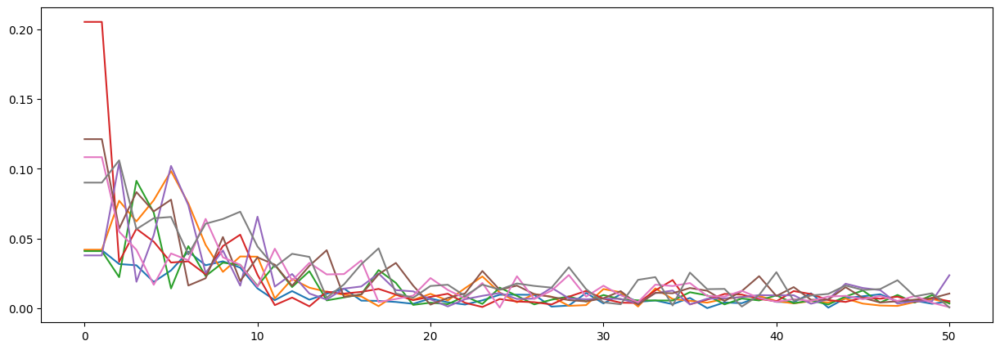

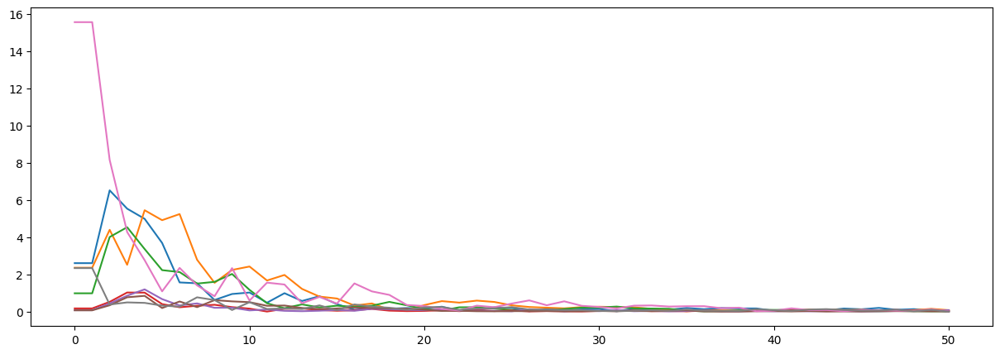

In [132]:
fft_tensorPlot = fft_tensor.detach().clone()
target_overall_tensorplt = target_overall_tensor.detach().clone()
# display(target_overall_tensorplt)

display(fft_tensorPlot.shape)
display(fft_tensorPlot[0].shape)

end = 51
plt.figure(figsize = (15,5))
for i in range(8):
  plt.plot(np.abs(fft_tensorPlot[22,i,:51]))

plt.figure(figsize = (15,5))
for i in range(8):
  plt.plot(np.abs(fft_tensorPlot[24,i,:51]))
# plt.plot(fft_tensorPlot[0,1,:])
# plt.plot(fft_tensorPlot[0,2,:])
# plt.plot(fft_tensorPlot[0,3,:])
# plt.plot(fft_tensorPlot[0,4,:])
# plt.plot(fft_tensorPlot[0,5,:])
# plt.plot(fft_tensorPlot[0,6,:])
# plt.plot(fft_tensorPlot[0,7,:])


## Test model on the data

________________________________________________________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch.Size([1, 64])
len of combine: torch.Size([1, 128])
len of out: torch.Size([1, 6])
_________________
len of fft: torch.Size([1, 64])
len of x: torch

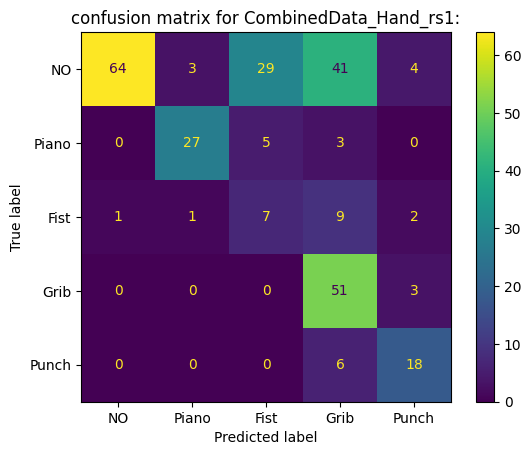

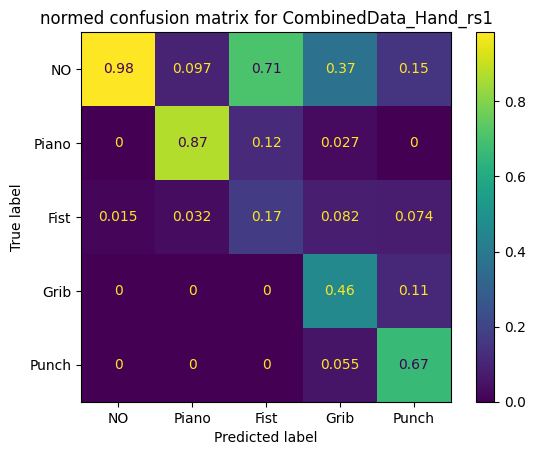

In [133]:
print("________________________________________________________________")
y_trues, predicteds, probs = PredAndShowStats(model,Head_random_dl,device,name)


probs = torch.tensor(probs)
m = nn.Softmax(dim=0)
probs = m(probs)

y_trues = y_trues.clone().detach()
predicteds = predicteds.clone().detach()
probs = probs.clone().detach()
probs = probs.squeeze(1)

# print("_____")
# print(raw_org_tensor.shape)


# print(segmented_data_tensor.shape)
# print(label_org_tensor.shape)
# print(y_trues.shape)
# print(predicteds.shape)
# print(probs.shape)
# print("_____")

# print(label_org_tensor[0:5])
# print(y_trues[0:5])
# print(predicteds[0:5])
# print(probs[0:5])


# Make emsampled learning

In [134]:

def reconstruct_data(labels, data_length, window_samples, overlap_samples):
    stride = window_samples - overlap_samples

    reconstructed_labels = np.zeros(data_length)
    count = np.zeros(data_length)  # To keep track of overlap for averaging

    idx = 0
    for i in range(0, data_length - window_samples + 1, stride):
        reconstructed_labels[i:i + window_samples] += labels[idx]
        count[i:i + window_samples] += 1
        idx += 1

    # Handle overlapping regions by averaging

    reconstructed_labels /= count

    return reconstructed_labels


# y_trues, predicteds, probs

fs = 100
window_samples = int(windowSize_Sec * fs)
overlap_samples = int(overlap_Sec  * fs)


# Example usage
data_length = len(label_org_tensor)  # Original data length
labels = y_trues    # List of overlapping label segments

print(len(label_org_tensor)/100)
print(labels.shape)

labels = labels.cpu().numpy()
reconstructed_y_trues = reconstruct_data(labels,
                                        data_length, window_samples, overlap_samples
)

pred_np = predicteds.clone().detach().cpu().numpy()

reconstructed_pred = reconstruct_data(pred_np, data_length, window_samples, overlap_samples)

pr_np = probs.clone().detach().cpu().numpy()

# for i in range(pr_np.shape[1]):
#   print(i)
#   pr = probs[:,i]
#   pr = pr.cpu().numpy()
#   reconstructed_pred = reconstruct_data(pr, data_length, window_samples, overlap_samples)


247.04
torch.Size([274])


<ipython-input-134-21f0806dd80d>:15: RuntimeWarning:

invalid value encountered in divide



In [135]:
# print(pr_np.shape[1])


result = torch.tensor([])

for i in range(pr_np.shape[1]):
  # print(i)

  pr = pr_np[:,i]
  res = reconstruct_data(pr, data_length, window_samples, overlap_samples)
  res = torch.tensor(res)
  res = res.unsqueeze(0)


  result = torch.cat((result, res), 0)
  # result = torch.cat()
  # print(res.shape)

  # result = np.concatenate((result, res), axis=1)


<ipython-input-134-21f0806dd80d>:15: RuntimeWarning:

invalid value encountered in divide



torch.Size([6, 24704])
tensor([0.0036, 0.0026, 0.0031, 0.0080, 0.0022, 0.0031], dtype=torch.float64)
torch.Size([24704])


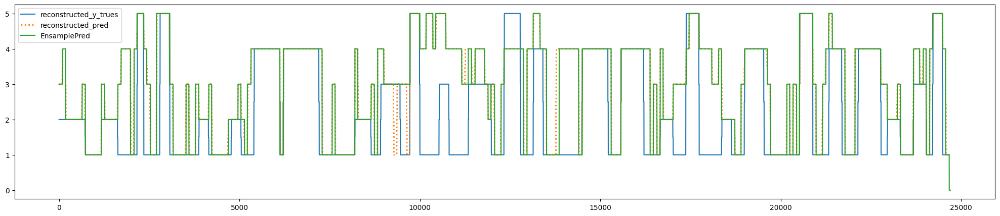

In [136]:

print(result.shape)
print(result[:,0])

EnsamplePred = torch.argmax(result, dim=0)

print(EnsamplePred.shape)

plt.figure(figsize=(25,5))
# plt.plot(label_org_tensor)
plt.plot(reconstructed_y_trues,label="reconstructed_y_trues")
plt.plot(reconstructed_pred,":",label="reconstructed_pred",linewidth=2)
plt.plot(EnsamplePred,label="EnsamplePred")
plt.legend()
plt.show()



In [137]:
import plotly.express as px
import plotly.graph_objects as go


 # ser1 = pd.Series(, copy=False)



fs = 100
st = 1/fs
print(st)
d = np.arange(start=0, stop=len(label_org_tensor)/fs,step = st)


f = pd.DataFrame({'Timeline': d,
                   'True': label_org_tensor.detach().numpy(),
                   'reconstructed_y_trues': np.round(reconstructed_y_trues,0),
                   'reconstructed_pred': np.round(reconstructed_pred,0),
                   'EnsamplePred': EnsamplePred.detach().numpy(),
                   'Raw1':raw_org_tensor[:,-2]*3,
                   'Raw2':raw_org_tensor[:,-1]*3,
                   })

fig = px.line(f,x="Timeline",y=['True','reconstructed_y_trues','reconstructed_pred','EnsamplePred','Raw1','Raw2'])

fig.update_xaxes(
    rangeslider_visible=True
)
fig.show()


# plt.figure(figsize=(35,5))

# # plt.plot(label_org_tensor)
# plt.plot(reconstructed_y_trues)
# plt.plot(reconstructed_pred)
# plt.plot(EnsamplePred)


# # plt.plot(labled_data_dominate_tensor)
# # plt.plot(labled_data_dominate_tensor_0)
# plt.plot(label_org_tensor)
# plt.plot(reconstructed_labels)
# plt.plot(reconstructed_pred)
# plt.plot(predicteds)


# segmented_data_tensor_0, segmented_fft_tensor_0,labled_data_samplewise_tensor_0, labled_data_dominate_tensor_0




0.01


# RMSE

In [138]:


def ExtractInformation(label_org,name=None,printer=False):

    movement_mapping = {
    0.0: "NA",
    1.0: "No movement",
    2.0: "piano",
    3.0: "fist",
    4.0: "grib",
    5.0: "punch"
    }


    all_lables = pd.Series(label_org)
    all_lables = all_lables.map(movement_mapping)


    InfoL0 = all_lables.value_counts(dropna=True)
    InfoL1 = all_lables.value_counts(dropna=True,normalize=True)
    fs = 100
    LengthOfMovements = InfoL0/fs
    LengthOfMovements = pd.Series(LengthOfMovements,name="Len_s")


    info = pd.concat([InfoL0, np.round(InfoL1,2),LengthOfMovements], axis=1)
    display(info)


    diff = np.diff(label_org)
    diff = (diff**2)**0.5

    diff[diff>0.01] = 1
    diff = pd.Series(diff)

    trigger_count = diff[diff == 1].count()
    trigger_Idx = diff[diff == 1].index

    if printer:
        plt.figure(figsize=(15,4))
        plt.plot(label_org)
        plt.plot(diff)

    fs = 100


    info = {}
    info["0.0"] = []
    info["1.0"] = []
    info["2.0"] = []
    info["3.0"] = []
    info["4.0"] = []
    info["5.0"] = []

    for i, idx in enumerate(trigger_Idx):
        if i == 0:
            s1 = 0
            s2 = (trigger_Idx[i])
        else:
            s1 = (trigger_Idx[i-1]+1)
            s2 = (trigger_Idx[i])

        section = (label_org[s1:s2])
        xlin = np.arange(s1,s2)
        if printer:
            plt.plot(xlin,section,linewidth=5)
        sectionLen = len(section)/fs
        # print(sectionLen)
        # section = section.float()



        if torch.is_tensor(label_org):
          s = (label_org[s1].float()).cpu().numpy()
        else:
          s = label_org[s1]

        # print(str(s))
        info[str(s)].append(sectionLen)

    if printer:
        plt.show()


    def movementInfo(info,name=""):
        TotalLen = np.sum(info)
        N_Movements = len(info)
        if N_Movements>0:
            std_len = np.std(info)
            mean_len = np.mean(info)
        else:
            std_len = 0
            mean_len = 0
        print(f"Information for: {name} \t Total len: {np.round(TotalLen,2)}s \t N_movements: {N_Movements} \t mean lenght: {np.round(mean_len,2)}s    \t std lenght: {np.round(std_len,2)}s")
        return TotalLen

    TotalLen1 = movementInfo(info["0.0"],"NA")
    TotalLen1 += movementInfo(info["1.0"],"No")
    TotalLen1 += movementInfo(info["2.0"],"Piano")
    TotalLen1 += movementInfo(info["3.0"],"Fist")
    TotalLen1 += movementInfo(info["4.0"],"Grib")
    TotalLen1 += movementInfo(info["5.0"],"Punch")
    print(f"Total len {np.round(TotalLen1,2)}")




In [139]:

f = pd.DataFrame({'Timeline': d,
                   'True': label_org_tensor.detach().numpy(),
                   'reconstructed_y_trues': np.round(reconstructed_y_trues,0),
                   'reconstructed_pred': np.round(reconstructed_pred,0),
                   'EnsamplePred': EnsamplePred.detach().numpy(),
                   'Raw1':raw_org_tensor[:,-2]*3,
                   'Raw2':raw_org_tensor[:,-1]*3,
                   })


# y_trues, predicteds, probs
print("y_trues")
print("__________________________________________________________________")
ExtractInformation(label_org_tensor.detach(),name="label_org_tensor")
print("__________________________________________________________________")
ExtractInformation(np.round(reconstructed_y_trues,0),name="reconstructed_y_trues")
print("__________________________________________________________________")
ExtractInformation(np.round(reconstructed_pred,0),name="reconstructed_pred")
print("__________________________________________________________________")
ExtractInformation(np.round(EnsamplePred,0),name="EnsamplePred")


y_trues
__________________________________________________________________


,count,proportion,Len_s
No movement,12632,0.51,126.32
grib,4902,0.20,49.02
piano,3171,0.13,31.71
punch,2105,0.09,21.05
fist,1894,0.08,18.94


Information for: NA 	 Total len: 0.0s 	 N_movements: 0 	 mean lenght: 0s    	 std lenght: 0s
Information for: No 	 Total len: 123.94s 	 N_movements: 26 	 mean lenght: 4.77s    	 std lenght: 2.54s
Information for: Piano 	 Total len: 31.63s 	 N_movements: 8 	 mean lenght: 3.95s    	 std lenght: 1.28s
Information for: Fist 	 Total len: 18.9s 	 N_movements: 4 	 mean lenght: 4.73s    	 std lenght: 1.38s
Information for: Grib 	 Total len: 48.94s 	 N_movements: 8 	 mean lenght: 6.12s    	 std lenght: 2.06s
Information for: Punch 	 Total len: 20.98s 	 N_movements: 7 	 mean lenght: 3.0s    	 std lenght: 1.0s
Total len 244.39
__________________________________________________________________


,count,proportion,Len_s
No movement,12430,0.50,124.3
grib,4780,0.19,47.8
piano,3470,0.14,34.7
punch,2090,0.08,20.9
fist,1900,0.08,19.0


Information for: NA 	 Total len: 0.0s 	 N_movements: 0 	 mean lenght: 0s    	 std lenght: 0s
Information for: No 	 Total len: 122.24s 	 N_movements: 26 	 mean lenght: 4.7s    	 std lenght: 2.46s
Information for: Piano 	 Total len: 34.38s 	 N_movements: 32 	 mean lenght: 1.07s    	 std lenght: 1.85s
Information for: Fist 	 Total len: 18.82s 	 N_movements: 18 	 mean lenght: 1.05s    	 std lenght: 1.91s
Information for: Grib 	 Total len: 47.72s 	 N_movements: 8 	 mean lenght: 5.96s    	 std lenght: 2.1s
Information for: Punch 	 Total len: 20.83s 	 N_movements: 7 	 mean lenght: 2.98s    	 std lenght: 0.81s
Total len 243.99
__________________________________________________________________


,count,proportion,Len_s
grib,9960,0.40,99.6
No movement,5570,0.23,55.7
fist,3450,0.14,34.5
piano,3360,0.14,33.6
punch,2330,0.09,23.3


Information for: NA 	 Total len: 0.0s 	 N_movements: 0 	 mean lenght: 0s    	 std lenght: 0s
Information for: No 	 Total len: 54.52s 	 N_movements: 28 	 mean lenght: 1.95s    	 std lenght: 1.38s
Information for: Piano 	 Total len: 32.99s 	 N_movements: 61 	 mean lenght: 0.54s    	 std lenght: 1.11s
Information for: Fist 	 Total len: 34.11s 	 N_movements: 39 	 mean lenght: 0.87s    	 std lenght: 0.69s
Information for: Grib 	 Total len: 99.27s 	 N_movements: 33 	 mean lenght: 3.01s    	 std lenght: 2.81s
Information for: Punch 	 Total len: 23.2s 	 N_movements: 10 	 mean lenght: 2.32s    	 std lenght: 0.81s
Total len 244.09
__________________________________________________________________


,count,proportion,Len_s
grib,9470,0.38,94.70
No movement,5810,0.24,58.10
fist,4000,0.16,40.00
piano,2860,0.12,28.60
punch,2530,0.10,25.30
NA,34,0.00,0.34


Information for: NA 	 Total len: 0.0s 	 N_movements: 0 	 mean lenght: 0s    	 std lenght: 0s
Information for: No 	 Total len: 57.83s 	 N_movements: 27 	 mean lenght: 2.14s    	 std lenght: 1.42s
Information for: Piano 	 Total len: 28.5s 	 N_movements: 10 	 mean lenght: 2.85s    	 std lenght: 1.14s
Information for: Fist 	 Total len: 39.69s 	 N_movements: 31 	 mean lenght: 1.28s    	 std lenght: 1.21s
Information for: Grib 	 Total len: 94.39s 	 N_movements: 31 	 mean lenght: 3.04s    	 std lenght: 2.83s
Information for: Punch 	 Total len: 25.2s 	 N_movements: 10 	 mean lenght: 2.52s    	 std lenght: 0.81s
Total len 245.61


In [140]:
#@title plot

from plotly.subplots import make_subplots


def plotInteractive(df,Match,d):
    fig = go.Figure()

    fig = make_subplots(specs=[[{"secondary_y": True}]])
    colors = px.colors.qualitative.Plotly
    print("colors " + str(len(colors)))
    print("df.columns " + str(len(df.columns)))

    # set up multiple traces
    for col in df.columns:
        if any(element in col for element in ["Match"]):
           fig.add_trace(go.Scatter(
            x = d,
            y=Match*0.5,
            fill="tozeroy",
            mode="lines",
            line_color="darkblue",
            opacity=0.001,
            name=col,
            visible=True,
            ),


               secondary_y=True,
                  )

        if any(element in col for element in ["y_pred","y_true"]):
            # print("PLOT YPRED")
            fig.add_trace(go.Scatter(x=df.index,
                                    y=df[col],
                                    name  = col,
                                    visible=True
                                    ),
                                    secondary_y=True
                        )

        else:
            fig.add_trace(go.Scatter(x=df.index,
                                y=df[col],
                                name  = col,
                                visible=True
                                )
                        )




    um = [ {} for _ in range(len(df.columns)) ]
    buttons = []
    menuadjustment = 0.15

    buttonX = -0.1
    buttonY = 1 + menuadjustment
    for i, col in enumerate(df.columns):
        button = dict(method='restyle',
                    label=col,
                    visible=True,
                    args=[{'visible':True,
                            'line.color' : colors[i%10]}, [i]],
                    args2 = [{'visible': False,
                                'line.color' : colors[i%10]}, [i]],
                    )

        # adjust some button features
        buttonY = buttonY-menuadjustment
        um[i]['buttons'] = [button]
        um[i]['showactive'] = False
        um[i]['y'] = buttonY
        um[i]['x'] = buttonX

    # add a button to toggle all traces on and off
    button2 = dict(method='restyle',
                label='All',
                visible=True,
                args=[{'visible':True}],
                args2 = [{'visible': False}],
                )
    # assign button2 to an updatemenu and make some adjustments
    um.append(dict())
    um[i+1]['buttons'] = [button2]
    um[i+1]['showactive'] = True
    um[i+1]['y']=buttonY - menuadjustment
    um[i+1]['x'] = buttonX

    # add dropdown menus to the figure
    fig.update_layout(showlegend=True, updatemenus=um)

    fig.update_xaxes(
        rangeslider_visible=True
    )
    # adjust button type
    for m in fig.layout.updatemenus:
        m['type'] = 'buttons'

    # f = fig.full_figure_for_development(warn=False)
    fig.show()





f = pd.DataFrame({'Timeline': d,
                   'True': label_org_tensor.detach().numpy(),
                   'reconstructed_y_trues': np.round(reconstructed_y_trues,0),
                   'reconstructed_pred': np.round(reconstructed_pred,0),
                   'EnsamplePred': EnsamplePred.detach().numpy(),
                   'Raw1':raw_org_tensor[:,-2]*3,
                   'Raw2':raw_org_tensor[:,-1]*3,
                   })




# print(target_names)
plotdata = pd.DataFrame(raw_org_tensor, columns=['x:left','y:left','z:left','x:rigth','y:rigth','z:rigth','meg:left','meg:right'])

plotdata['Timeline_s'] = d
plotdata['y_true'] = label_org_tensor.detach().numpy()
plotdata['y_pred'] = np.round(reconstructed_pred,0)
plotdata['y_pred_en'] = EnsamplePred.detach().numpy()
plotdata = plotdata.set_index(['Timeline_s'])
plotdata.info()
# # df = df.cumsum()
Match = plotdata['y_true']==plotdata['y_pred_en']
plotdata['Match'] = Match

plotInteractive(plotdata,Match,d)
Match = plotdata['y_true']==plotdata['y_pred']
plotdata['Match'] = Match

plotInteractive(plotdata,Match,d)

<class 'pandas.core.frame.DataFrame'>
Index: 24704 entries, 0.0 to 247.03
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   x:left     24704 non-null  float32
 1   y:left     24704 non-null  float32
 2   z:left     24704 non-null  float32
 3   x:rigth    24704 non-null  float32
 4   y:rigth    24704 non-null  float32
 5   z:rigth    24704 non-null  float32
 6   meg:left   24704 non-null  float32
 7   meg:right  24704 non-null  float32
 8   y_true     24704 non-null  int64  
 9   y_pred     24670 non-null  float64
 10  y_pred_en  24704 non-null  int64  
dtypes: float32(8), float64(1), int64(2)
memory usage: 1.5 MB
colors 10
df.columns 12


colors 10
df.columns 12


In [141]:


plotdata['y_true'] = plotdata['y_true'].fillna(1)
plotdata['y_pred'] = plotdata['y_pred'].fillna(1)
plotdata['y_pred_en'] = plotdata['y_pred_en'].fillna(1)

plotdata['y_pred_en'][plotdata['y_pred_en']==0] = 1


values, counts = np.unique(plotdata['y_pred_en'], return_counts=True)
print(values)
print(counts)


[1 2 3 4 5]
[5844 2860 4000 9470 2530]


<ipython-input-141-34c4a96038f0>:5: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


<ipython-input-141-34c4a96038f0>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documen

____________________________________________

BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1
without overlap
              precision    recall  f1-score   support

          NO       0.98      0.44      0.60     12632
       Piano       0.73      0.77      0.75      3171
        Fist       0.18      0.33      0.23      1894
        Grib       0.47      0.95      0.63      4902
       Punch       0.63      0.69      0.66      2105

    accuracy                           0.59     24704
   macro avg       0.60      0.64      0.57     24704
weighted avg       0.76      0.59      0.60     24704



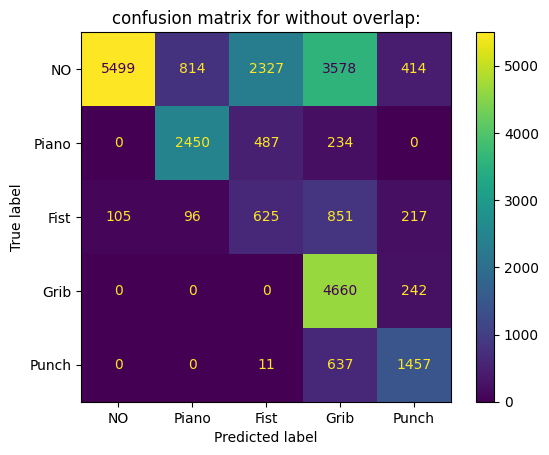

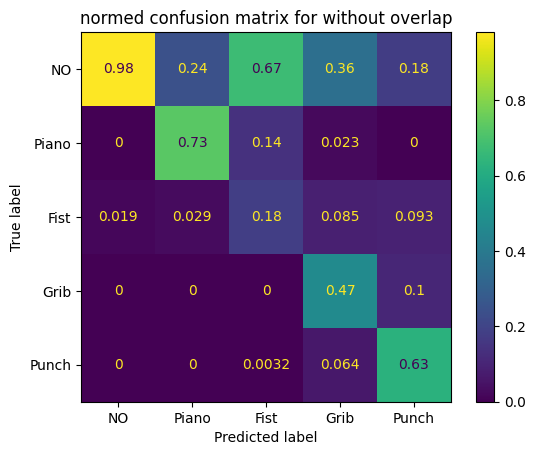

____________________________________________

BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1
with overlap
              precision    recall  f1-score   support

          NO       0.99      0.46      0.63     12632
       Piano       0.87      0.79      0.83      3171
        Fist       0.20      0.42      0.27      1894
        Grib       0.49      0.94      0.64      4902
       Punch       0.59      0.71      0.64      2105

    accuracy                           0.62     24704
   macro avg       0.63      0.66      0.60     24704
weighted avg       0.78      0.62      0.63     24704



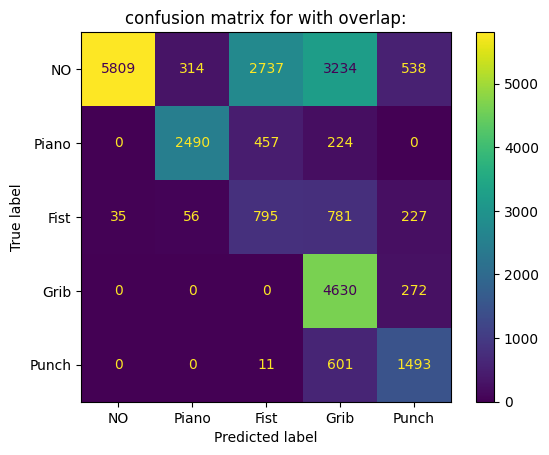

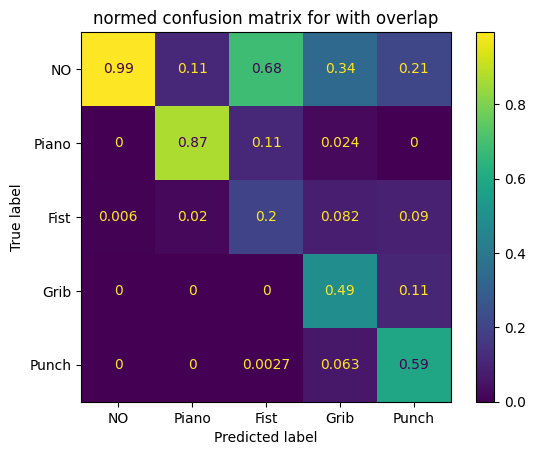

____________________________________________

BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1
no overlap vs overlap
              precision    recall  f1-score   support

          NO       0.93      0.97      0.95      5604
       Piano       0.99      0.84      0.91      3360
        Fist       0.84      0.98      0.91      3450
        Grib       1.00      0.95      0.97      9960
       Punch       0.92      1.00      0.96      2330

    accuracy                           0.95     24704
   macro avg       0.94      0.95      0.94     24704
weighted avg       0.95      0.95      0.95     24704



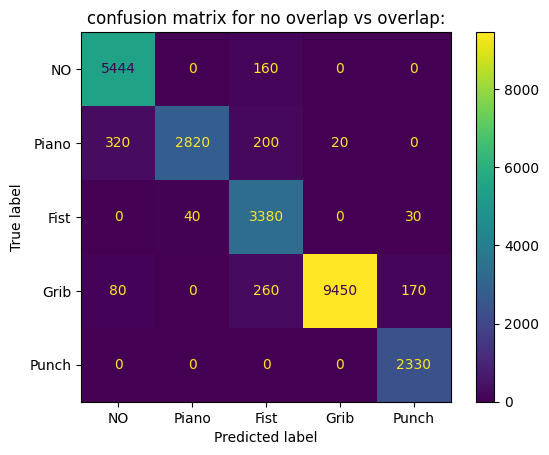

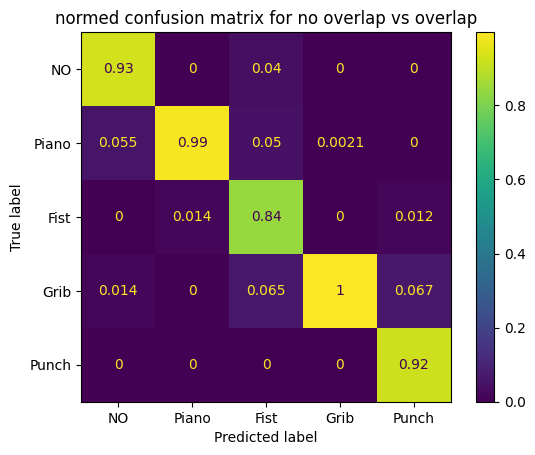


BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1


In [142]:
#@title Evaluate Confusionmatrix

print("____________________________________________")
print()
print(ModelName)
print(name)

ShowStatsForModel(plotdata['y_true'],plotdata['y_pred'],"without overlap")
print("____________________________________________")
print()
print(ModelName)
print(name)

ShowStatsForModel(plotdata['y_true'],plotdata['y_pred_en'],"with overlap")
print("____________________________________________")
print()
print(ModelName)
print(name)

ShowStatsForModel(plotdata['y_pred'],plotdata['y_pred_en'],"no overlap vs overlap")





# plotdata['y_true'] = label_org_tensor.detach().numpy()
# plotdata['y_pred'] = np.round(reconstructed_pred,0)
# plotdata['y_pred_en'] = EnsamplePred.detach().numpy()

print()
print(ModelName)
print(name)


Plot the random signal, with both True Classification and Predicted

Therefor will The signal først be voted for each sample

In [143]:

from sklearn.metrics import mean_pinball_loss, mean_squared_error

y_true = plotdata['y_true']
y_pred = plotdata['y_pred']
y_pred_en = plotdata['y_pred_en']



def reassign(signal):
    signal[signal==1] = 1
    signal[signal==2] = 2
    signal[signal==3] = 3
    signal[signal==4] = 4
    signal[signal==5] = 5
    return signal
# print("2X2")

trueRe = reassign(y_true.copy())
y_predRe = reassign(y_pred.copy())
y_pred_enRe = reassign(y_pred_en.copy())

from sklearn.metrics import mean_squared_error, cohen_kappa_score
from math import sqrt

# print(trueRe["true"])
display(trueRe.head())
display(trueRe.info())





,y_true
Timeline_s,
0.00,2
0.01,2
0.02,2
0.03,2
0.04,2


<class 'pandas.core.series.Series'>
Index: 24704 entries, 0.0 to 247.03
Series name: y_true
Non-Null Count  Dtype
--------------  -----
24704 non-null  int64
dtypes: int64(1)
memory usage: 386.0 KB


None

In [144]:
#@title Evaluate RMS with overlap

print(ModelName)
print(name)
print()

print("y_pred with overlap")
results = []

metrics = {"class ": "overall"}
for alpha in [0.05, 0.5, 0.95]:
      metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(trueRe, y_pred_en, alpha=alpha)
metrics["MSE"] = mean_squared_error(trueRe, y_pred_en)
metrics["RMSE"] = sqrt(mean_squared_error(trueRe, y_pred_en))

print(f"RMSE \t: {np.round(sqrt(mean_squared_error(trueRe, y_pred_en)),3)}")

results.append(metrics)


for i in [1,2,3,4,5]:
  idx = trueRe[trueRe==i].index
  t_value = trueRe[idx]
  p_value = y_pred_en[idx]

  # print(t_value)
  # print(p_value)

  rmse = sqrt(mean_squared_error(t_value, p_value))
  print(f"RMSE for {i}: {np.round(rmse,3)}")
  metrics = {"class ": str(i)}

  for alpha in [0.05, 0.5, 0.95]:
      metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(t_value, p_value, alpha=alpha)
  metrics["MSE"] = mean_squared_error(t_value, p_value)
  metrics["RMSE"] = sqrt(mean_squared_error(t_value, p_value))
  results.append(metrics)

# print("Without overlap")
# display(results)



# print("With overlap")
# display(results)

def highlight_min(x):
    x_min = x.min()
    return ["font-weight: bold" if v == x_min else "" for v in x]



display(pd.DataFrame(results).style.apply(highlight_min))
# display(pd.DataFrame(results))#.style.apply(highlight_min)


BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1

y_pred with overlap
RMSE 	: 1.467
RMSE for 1: 1.969
RMSE for 2: 0.653
RMSE for 3: 0.998
RMSE for 4: 0.236
RMSE for 5: 0.554


,class,pbl=0.05,pbl=0.50,pbl=0.95,MSE,RMSE
0,overall,0.772699,0.421045,0.069392,2.150704,1.466528
1,1,1.326781,0.698306,0.069831,3.877137,1.969045
2,2,0.271129,0.142699,0.014270,0.426679,0.653207
3,3,0.622782,0.359293,0.095803,0.995248,0.997621
4,4,0.052713,0.027744,0.002774,0.055488,0.235558
5,5,0.014798,0.147981,0.281164,0.306413,0.553546


In [145]:
#@title Evaluate RMS without overlap

print(ModelName)
print(name)
print()


print("y_pred without overlap")

results = []

metrics = {"class ": "overall"}
for alpha in [0.05, 0.5, 0.95]:
      metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(trueRe, y_predRe, alpha=alpha)
metrics["MSE"] = mean_squared_error(trueRe, y_predRe)
metrics["RMSE"] = sqrt(mean_squared_error(trueRe, y_predRe))
print(f"RMSE \t: {np.round(sqrt(mean_squared_error(trueRe, y_predRe)),3)}")

results.append(metrics)


for i in [1,2,3,4,5]:
  idx = trueRe[trueRe==i].index
  t_value = trueRe[idx]
  p_value = y_predRe[idx]

  # print(t_value)
  # print(p_value)

  rmse = sqrt(mean_squared_error(t_value, p_value))
  print(f"RMSE for {i}: {np.round(rmse,3)}")

  metrics = {"class ": str(i)}

  for alpha in [0.05, 0.5, 0.95]:
      metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(t_value, p_value, alpha=alpha)
  metrics["MSE"] = mean_squared_error(t_value, p_value)
  metrics["RMSE"] = sqrt(mean_squared_error(t_value, p_value))
  results.append(metrics)

# print("Without overlap")
# display(results)



# print("With overlap")
# display(results)

def highlight_min(x):
    x_min = x.min()
    return ["font-weight: bold" if v == x_min else "" for v in x]



display(pd.DataFrame(results).style.apply(highlight_min))
# display(pd.DataFrame(results))#.style.apply(highlight_min)



BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1

y_pred without overlap
RMSE 	: 1.472
RMSE for 1: 1.968
RMSE for 2: 0.67
RMSE for 3: 1.086
RMSE for 4: 0.222
RMSE for 5: 0.569


,class,pbl=0.05,pbl=0.50,pbl=0.95,MSE,RMSE
0,overall,0.784134,0.431205,0.078277,2.166815,1.472011
1,1,1.343026,0.706856,0.070686,3.874921,1.968482
2,2,0.286108,0.150583,0.015058,0.448754,0.669891
3,3,0.652614,0.420011,0.187408,1.180042,1.086297
4,4,0.046899,0.024684,0.002468,0.049368,0.222188
5,5,0.015653,0.156532,0.297411,0.323515,0.568784


# Cohen kappa

In [146]:
#@title Evaluate kappe
def CalcKappa(true,pred,pred_en,kappamap=[1,2,3,4,5],kappename=""):


  print(kappename)
  def reassign(signal):
      signal[signal==1] = kappamap[0]
      signal[signal==2] = kappamap[1]
      signal[signal==3] = kappamap[2]
      signal[signal==4] = kappamap[3]
      signal[signal==5] = kappamap[4]
      return signal

  print(kappamap)
  trueRe = reassign(true.copy())
  predRe = reassign(pred.copy())
  predenRe = reassign(pred_en.copy())

  kappa_pred = cohen_kappa_score(trueRe,predRe,weights="linear")
  print(f"pred kappa weights: \t\t{np.round(kappa_pred,3)}")
  kappa_pred = cohen_kappa_score(trueRe,predRe)
  print(f"pred kappa: \t\t{np.round(kappa_pred,3)}")

  kappa_preden = cohen_kappa_score(trueRe,predenRe,weights="linear")
  print(f"pred ensample kappa weights: \t{np.round(kappa_preden,3)}")
  kappa_preden = cohen_kappa_score(trueRe,predenRe)
  print(f"pred ensample kappa: \t{np.round(kappa_preden,3)}")



kappamap = [1,2,3,4,5]
CalcKappa(trueRe.copy(),y_predRe.copy(),y_pred_en.copy(),kappamap,kappename = "5x5")
kappamap = [1,1,1,4,5]
CalcKappa(trueRe.copy(),y_predRe.copy(),y_pred_en.copy(),kappamap,kappename = "3x3")
kappamap = [1,1,1,5,5]
CalcKappa(trueRe.copy(),y_predRe.copy(),y_pred_en.copy(),kappamap,kappename = "2x2")

print()
print(ModelName)
print(name)

5x5
[1, 2, 3, 4, 5]
pred kappa weights: 		0.495
pred kappa: 		0.472
pred ensample kappa weights: 	0.508
pred ensample kappa: 	0.499
3x3
[1, 1, 1, 4, 5]
pred kappa weights: 		0.583
pred kappa: 		0.547
pred ensample kappa weights: 	0.594
pred ensample kappa: 	0.564
2x2
[1, 1, 1, 5, 5]
pred kappa weights: 		0.57
pred kappa: 		0.57
pred ensample kappa weights: 	0.589
pred ensample kappa: 	0.589

BestModel/best_model_model_acuuracy_72.0_lr_0.001_Conv_64_opt_Adam_Traindon_CombinedData_Arm_Hånd_Øre_s2s3s5s6s7
CombinedData_Hand_rs1


In [147]:

# print(target_names)
plotdata = pd.DataFrame(raw_org_tensor, columns=['x:left','y:left','z:left','x:rigth','y:rigth','z:rigth','meg:left','meg:right'])

plotdata['Timeline_s'] = d



plotdata['y_true'] = label_org_tensor.detach().numpy()
plotdata['y_pred'] = np.round(reconstructed_pred,0)
plotdata['y_pred_en'] = EnsamplePred.detach().numpy()




def reassign(signal):
    signal[signal==1] = 1
    signal[signal==2] = 1
    signal[signal==3] = 3
    signal[signal==4] = 4
    signal[signal==5] = 5
    return signal
# print("2X2")

plotdata['y_true'] = reassign(plotdata['y_true'].copy())
plotdata['y_pred'] = reassign(plotdata['y_pred'].copy())
plotdata['y_pred_en'] = reassign(plotdata['y_pred_en'].copy())



plotdata = plotdata.set_index(['Timeline_s'])
plotdata.info()
# # df = df.cumsum()
Match = plotdata['y_true']==plotdata['y_pred_en']
plotdata['Match'] = Match

plotInteractive(plotdata,Match,d)
Match = plotdata['y_true']==plotdata['y_pred']
plotdata['Match'] = Match

plotInteractive(plotdata,Match,d)

<class 'pandas.core.frame.DataFrame'>
Index: 24704 entries, 0.0 to 247.03
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   x:left     24704 non-null  float32
 1   y:left     24704 non-null  float32
 2   z:left     24704 non-null  float32
 3   x:rigth    24704 non-null  float32
 4   y:rigth    24704 non-null  float32
 5   z:rigth    24704 non-null  float32
 6   meg:left   24704 non-null  float32
 7   meg:right  24704 non-null  float32
 8   y_true     24704 non-null  int64  
 9   y_pred     24670 non-null  float64
 10  y_pred_en  24704 non-null  int64  
dtypes: float32(8), float64(1), int64(2)
memory usage: 1.5 MB
colors 10
df.columns 12


colors 10
df.columns 12


In [148]:
# #@title Evaluate RMS without overlap

# print(ModelName)
# print(name)
# print()

# trueRe = reassign(plotdata['y_true'].copy())
# y_predRe = reassign(plotdata['y_pred'].copy())


# print("y_pred without overlap")

# results = []

# metrics = {"class ": "overall"}
# for alpha in [0.05, 0.5, 0.95]:
#       metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(trueRe, y_predRe, alpha=alpha)
# metrics["MSE"] = mean_squared_error(trueRe, y_predRe)
# metrics["RMSE"] = sqrt(mean_squared_error(trueRe, y_predRe))
# print(f"RMSE \t: {np.round(sqrt(mean_squared_error(trueRe, y_predRe)),3)}")

# results.append(metrics)


# for i in [1,2,3,4,5]:
#   idx = trueRe[trueRe==i].index
#   t_value = trueRe[idx]
#   p_value = y_predRe[idx]

#   # print(t_value)
#   # print(p_value)

#   rmse = sqrt(mean_squared_error(t_value, p_value))
#   print(f"RMSE for {i}: {np.round(rmse,3)}")

#   metrics = {"class ": str(i)}

#   for alpha in [0.05, 0.5, 0.95]:
#       metrics["pbl=%1.2f" % alpha] = mean_pinball_loss(t_value, p_value, alpha=alpha)
#   metrics["MSE"] = mean_squared_error(t_value, p_value)
#   metrics["RMSE"] = sqrt(mean_squared_error(t_value, p_value))
#   results.append(metrics)

# # print("Without overlap")
# # display(results)



# # print("With overlap")
# # display(results)

# def highlight_min(x):
#     x_min = x.min()
#     return ["font-weight: bold" if v == x_min else "" for v in x]



# display(pd.DataFrame(results).style.apply(highlight_min))
# # display(pd.DataFrame(results))#.style.apply(highlight_min)



# Varighed
